every run in this notebook has

• ridge max height of 1/2 island max height

• resolution=(64x64)

here we're tesing what happens when the ridge is short (p

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import dedalus.public as d3
import logging
logger = logging.getLogger(__name__)
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib as mpl
mpl.rc('text', usetex = True)
mpl.rc('font', family = 'serif')
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rcParams.update({'font.size': 18})


In [2]:
import xarray as xr

In [3]:
from dedalus.core.operators import SpectralOperator1D

class ComplexFourierPseudodifferential(SpectralOperator1D):

    input_basis_type = d3.ComplexFourier
    subaxis_dependence = [True]
    subaxis_coupling = [False]

    def __init__(self, operand, coord, out=None):
        super().__init__(operand, out=out)
        # SpectralOperator requirements
        self.coord = coord
        self.input_basis = operand.domain.get_basis(coord)
        self.output_basis = self.input_basis
        self.first_axis = coord.axis
        self.last_axis = coord.axis
        self.axis = coord.axis
        # LinearOperator requirements
        self.operand = operand
        # FutureField requirements
        self.domain = operand.domain.substitute_basis(self.input_basis, self.output_basis)
        self.tensorsig = operand.tensorsig
        self.dtype = operand.dtype

    @classmethod
    def _group_matrix(cls, group, input_basis, output_basis):
        # Rescale group (native wavenumber) to get physical wavenumber
        k = group / input_basis.COV.stretch
        # dx exp(1j*k*x) = 1j * k * exp(1j*k*x)
        return np.array([[cls.k_func(k)]])


class abs_m_cls(ComplexFourierPseudodifferential):

    name = "abs_m"

    @classmethod
    def k_func(cls, k):
        return abs(k)

    def new_operand(self, operand, **kw):
        if operand == 0:
            return 0
        return abs_m_cls(operand,  self.coord, **kw)

In [16]:
def kinetic_energy(Φg,r,θ):
    dΦ_dr = np.gradient(Φg,r,axis=1)
    dΦ_dθ = 1/r*np.gradient(Φg,np.gradient(θ)[0],axis=0)
    gradΦ = dΦ_dr + dΦ_dθ
    ke = gradΦ*np.conj(gradΦ) 
    ke = xr.DataArray(ke.real, coords=[θ,r], dims = ['theta','r']) 
    return ke

def kinetic_energy_metric(ke,Rs):
    ridge_wedge = ke.where(ke.theta<np.pi+W).where(ke.theta>np.pi-W).sum('theta')
    basin_wedge = ke.where(ke.theta>np.pi+W).fillna(0)+ke.where(ke.theta<np.pi-W).fillna(0); 
    basin_wedge = basin_wedge.where(np.abs(basin_wedge>0)).sum('theta')
    metric = (ridge_wedge/(ridge_wedge+basin_wedge)).sel(r=slice(1,Rs))
    weights = np.gradient(metric.r)/sum(np.gradient(metric.r))
    metric = float((metric*weights).sum('r').values)
    return metric

def eigenmode_plot(i,R,THETA,j):
    fig,(ax,ax2,ax1) = plt.subplots(1,3, figsize=(14,4),gridspec_kw={'width_ratios': [1.3,1.3,2]})    
    X = R*np.cos(THETA); Y=R*np.sin(THETA)
    solver.set_state(i, solver.subproblems[0].subsystems[0]) 
    Φg = Φ['g']
    vmax=np.max(np.abs(Φg))*0.75;vmin=-vmax
    ax.pcolormesh(X,Y,Φg.real, vmin=vmin,vmax=vmax)
    ax.contour(X,Y,H, levels=[0.99,1], colors='k', alpha=0.5)
    vmax=np.max(np.abs(Φg[:,:int(Nr/8)]))*0.75;vmax=max(vmax,0.2);vmin=-vmax
#     ax2.pcolormesh(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],Φg.real[:,:int(Nr/6)], vmin=vmin,vmax=vmax)
#     ax2.contour(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],H[:,:int(Nr/6)], levels=[0.99,1], colors='k', alpha=0.5)
    ax2.pcolormesh(X[:,:j],Y[:,:j],Φg.real[:,:j], vmin=vmin,vmax=vmax)
    ax2.contour(X[:,:j],Y[:,:j],H[:,:j], levels=[0.99,1], colors='k', alpha=0.5)
    for j in range(Nθ):
        ax1.plot(r, Φg.real[j,:], 'k', alpha=0.5)
        ax1.axhline(0,color='k',linestyle='dashed')
    ax.set_ylabel(r'$\omega = $ %5.4f'%(1/solver.eigenvalues.real[i]))
    ax1.set_xlabel('$r$'); ax1.set_ylabel(r'$\Phi(r,\theta)$');
    ax.set_xticks([]);ax.set_yticks([]);ax2.set_xticks([]);ax2.set_yticks([])
    fig.tight_layout()
    plt.show()

# Case \#1


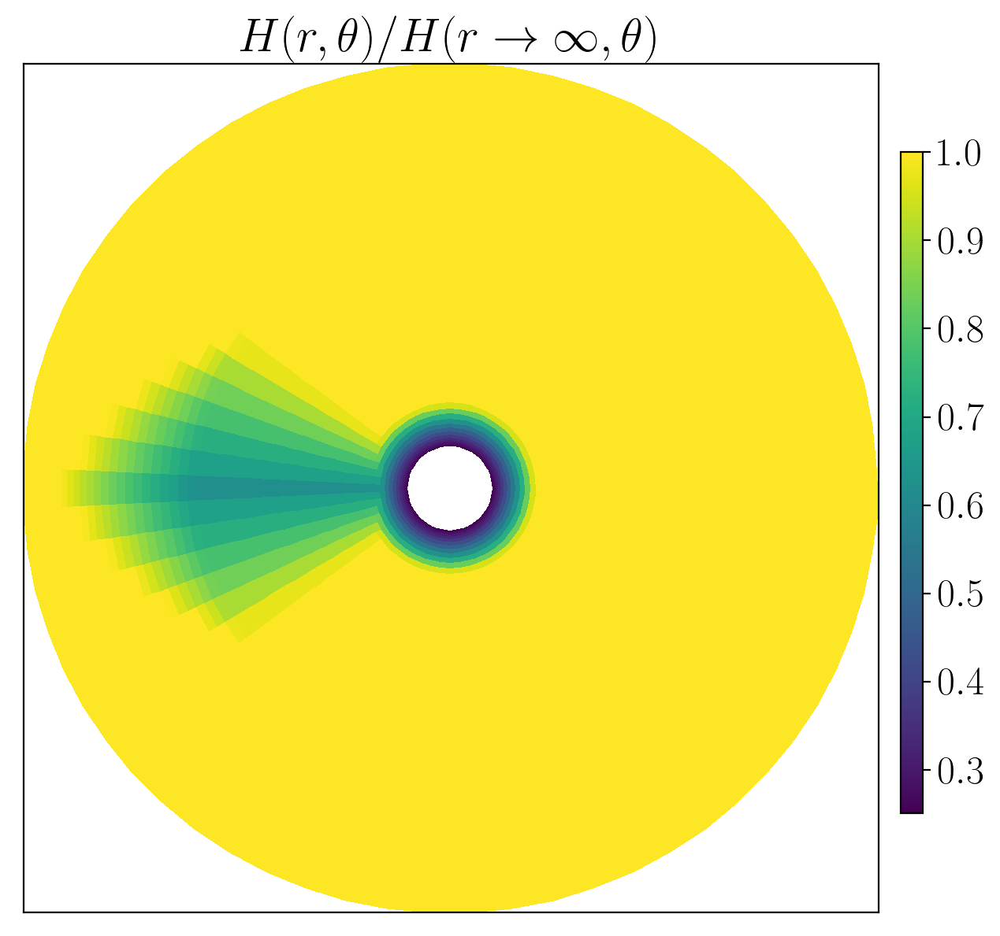

In [9]:
## variable parameters ##
Ro = 5;
Rs = 3;
Nθ = 64;
Nr = 64;
W = np.pi/5; 
frac = 0.5;
steep = 0.3;

plot_option = True;
##########################


## fixed and dependent parameters 
Ri= 0.5;
α = 1 
Hmin_island = Ri**(2*α);
Hmin_ridge = 1-(1-Hmin_island)*frac; 
b = -np.log(Hmin_ridge)/(2*W)
C = np.pi;

#Basis
coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')

# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)

rinv = dist.Field(bases=r_basis); rinv['g'] = r**(-1)

lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

## bathymetry ##
R,THETA = np.meshgrid(r,θ)
Hisland = R**(2*α) 
Hisland[Hisland>1] = 1
Hridge = np.exp(2*b*(np.abs(C-THETA)-W))
Hridge[Hridge>1] = 1
Hridge[R>Rs] = Hridge[R>Rs]*np.exp(steep*(R[R>Rs]-Rs))
# Hridge[R>Rs] = 1
Hridge[Hridge>1] = 1
H = np.where(Hisland<Hridge,Hisland,Hridge)

## bathymetry as field ##
Hinv = dist.Field(bases=(θ_basis,r_basis))
Hinv['g'] = H**(-1)

if plot_option==True:
    ## plot bathymetry
    R,THETA = np.meshgrid(r,θ)
    x = R*np.cos(THETA); y=R*np.sin(THETA)
    fig,(ax) = plt.subplots(1,1, figsize=(7,7))
    c=ax.pcolormesh(x,y,1/Hinv['g'].real)
    ax.set_title(r'$H(r,\theta)/H(r\to\infty, \theta)$')
    cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
    cbar=plt.colorbar(c,cax = cax,orientation='vertical',shrink = 0.5)
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC


In [11]:
%%time
## solver (edit names with each run) ##
solver = problem.build_solver(matrix_coupling=(True,True))
solver.solve_sparse(solver.subproblems[0], 40,-1/0.3) 

2022-10-14 10:17:47,732 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 4m 05s, Remaining: 0s, Rate: 4.1e-03/s
CPU times: user 3min 9s, sys: 56.2 s, total: 4min 5s
Wall time: 4min 26s


In [12]:
# extract r and \theta dimensions in more easy forms for plotting
r = r[0]; θ = θ.T[0]

In [13]:
case1_eigenvalues = 1/solver.eigenvalues.real

Hmmm okay so this seems to operate on the same mechanism (wavemaker not continuing wave) as the long limit...

In [ ]:
# case1_ridge_metric = np.zeros(40)
for i in range(40):
    eigenmode_plot(i,R,THETA,20)
#     solver.set_state(i, solver.subproblems[0].subsystems[0]) 
#     Φg = Φ['g'];ke = kinetic_energy(Φg,r,θ)
#     case1_ridge_metric[i] = kinetic_energy_metric(ke,Rs)

# Case \#2


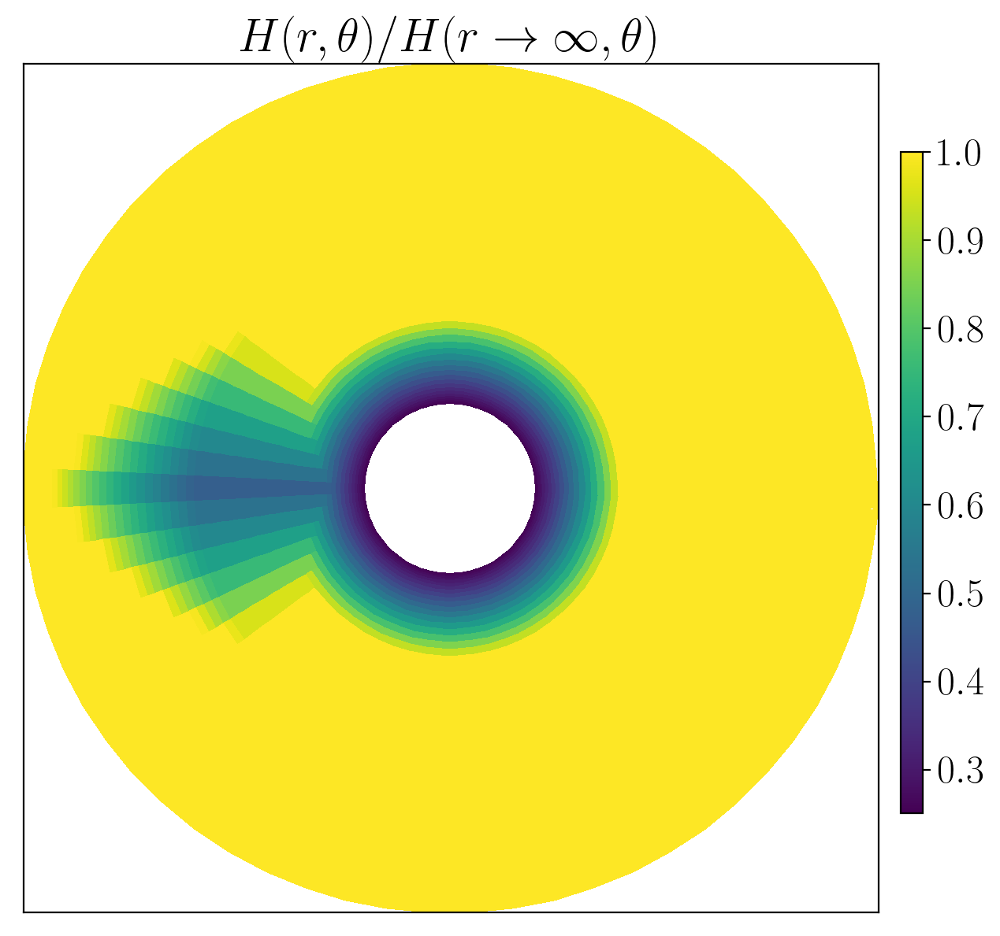

In [42]:
## variable parameters ##
Ro = 2.5;
Rs = 1.5;
Nθ = 64;
Nr = 64;
W = np.pi/5; 
frac = 0.7;
steep = 0.9;

plot_option = True;
##########################


## fixed and dependent parameters 
Ri= 0.5;
α = 1 
Hmin_island = Ri**(2*α);
Hmin_ridge = 1-(1-Hmin_island)*frac; 
b = -np.log(Hmin_ridge)/(2*W)
C = np.pi;

#Basis
coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')

# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)

rinv = dist.Field(bases=r_basis); rinv['g'] = r**(-1)

lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

## bathymetry ##
R,THETA = np.meshgrid(r,θ)
Hisland = R**(2*α) 
Hisland[Hisland>1] = 1
Hridge = np.exp(2*b*(np.abs(C-THETA)-W))
Hridge[Hridge>1] = 1
Hridge[R>Rs] = Hridge[R>Rs]*np.exp(steep*(R[R>Rs]-Rs))
# Hridge[R>Rs] = 1
Hridge[Hridge>1] = 1
H = np.where(Hisland<Hridge,Hisland,Hridge)

## bathymetry as field ##
Hinv = dist.Field(bases=(θ_basis,r_basis))
Hinv['g'] = H**(-1)

if plot_option==True:
    ## plot bathymetry
    R,THETA = np.meshgrid(r,θ)
    x = R*np.cos(THETA); y=R*np.sin(THETA)
    fig,(ax) = plt.subplots(1,1, figsize=(7,7))
    c=ax.pcolormesh(x,y,1/Hinv['g'].real)
    ax.set_title(r'$H(r,\theta)/H(r\to\infty, \theta)$')
    cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
    cbar=plt.colorbar(c,cax = cax,orientation='vertical',shrink = 0.5)
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC


In [43]:
%%time
## solver (edit names with each run) ##
solver = problem.build_solver(matrix_coupling=(True,True))
solver.solve_sparse(solver.subproblems[0], 40,-1/0.3) 

2022-10-14 10:40:54,731 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 4m 20s, Remaining: 0s, Rate: 3.8e-03/s
CPU times: user 3min 12s, sys: 1min 1s, total: 4min 14s
Wall time: 4min 41s


In [44]:
# extract r and \theta dimensions in more easy forms for plotting
r = r[0]; θ = θ.T[0]

In [45]:
case2_eigenvalues = 1/solver.eigenvalues.real

In [ ]:
# case1_ridge_metric = np.zeros(40)
for i in range(40):
    eigenmode_plot(i,R,THETA,40)
#     solver.set_state(i, solver.subproblems[0].subsystems[0]) 
#     Φg = Φ['g'];ke = kinetic_energy(Φg,r,θ)
#     case1_ridge_metric[i] = kinetic_energy_metric(ke,Rs)

# Case \#3


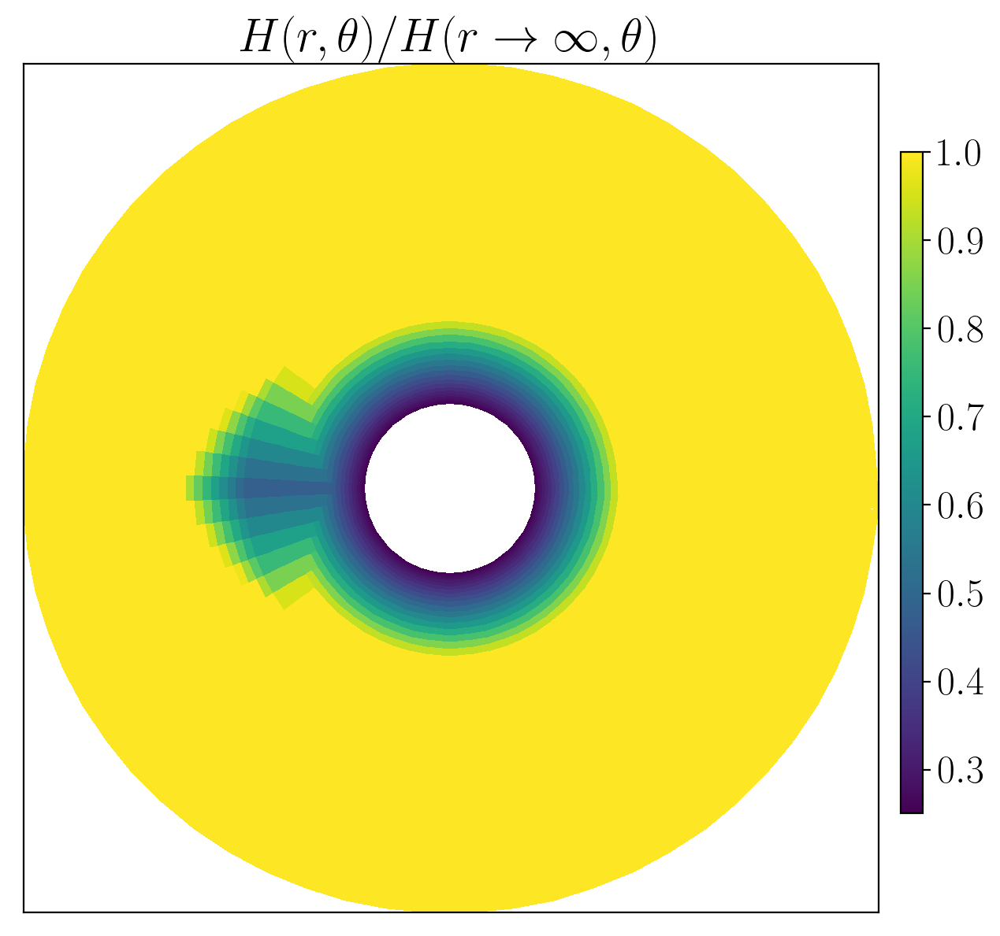

In [49]:
## variable parameters ##
Ro = 2.5;
Rs = 1.2;
Nθ = 64;
Nr = 64;
W = np.pi/5; 
frac = 0.7;
steep = 2;

plot_option = True;
##########################


## fixed and dependent parameters 
Ri= 0.5;
α = 1 
Hmin_island = Ri**(2*α);
Hmin_ridge = 1-(1-Hmin_island)*frac; 
b = -np.log(Hmin_ridge)/(2*W)
C = np.pi;

#Basis
coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')

# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)

rinv = dist.Field(bases=r_basis); rinv['g'] = r**(-1)

lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

## bathymetry ##
R,THETA = np.meshgrid(r,θ)
Hisland = R**(2*α) 
Hisland[Hisland>1] = 1
Hridge = np.exp(2*b*(np.abs(C-THETA)-W))
Hridge[Hridge>1] = 1
Hridge[R>Rs] = Hridge[R>Rs]*np.exp(steep*(R[R>Rs]-Rs))
# Hridge[R>Rs] = 1
Hridge[Hridge>1] = 1
H = np.where(Hisland<Hridge,Hisland,Hridge)

## bathymetry as field ##
Hinv = dist.Field(bases=(θ_basis,r_basis))
Hinv['g'] = H**(-1)

if plot_option==True:
    ## plot bathymetry
    R,THETA = np.meshgrid(r,θ)
    x = R*np.cos(THETA); y=R*np.sin(THETA)
    fig,(ax) = plt.subplots(1,1, figsize=(7,7))
    c=ax.pcolormesh(x,y,1/Hinv['g'].real)
    ax.set_title(r'$H(r,\theta)/H(r\to\infty, \theta)$')
    cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
    cbar=plt.colorbar(c,cax = cax,orientation='vertical',shrink = 0.5)
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC


In [50]:
%%time
## solver (edit names with each run) ##
solver = problem.build_solver(matrix_coupling=(True,True))
solver.solve_sparse(solver.subproblems[0], 40,-1/0.3) 

2022-10-14 10:49:24,564 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 4m 12s, Remaining: 0s, Rate: 4.0e-03/s
CPU times: user 3min 10s, sys: 58.2 s, total: 4min 9s
Wall time: 4min 34s


In [51]:
# extract r and \theta dimensions in more easy forms for plotting
r = r[0]; θ = θ.T[0]

In [52]:
case3_eigenvalues = 1/solver.eigenvalues.real

In [ ]:
# case1_ridge_metric = np.zeros(40)
for i in range(40):
    eigenmode_plot(i,R,THETA,40)
#     solver.set_state(i, solver.subproblems[0].subsystems[0]) 
#     Φg = Φ['g'];ke = kinetic_energy(Φg,r,θ)
#     case1_ridge_metric[i] = kinetic_energy_metric(ke,Rs)

## Case \#4

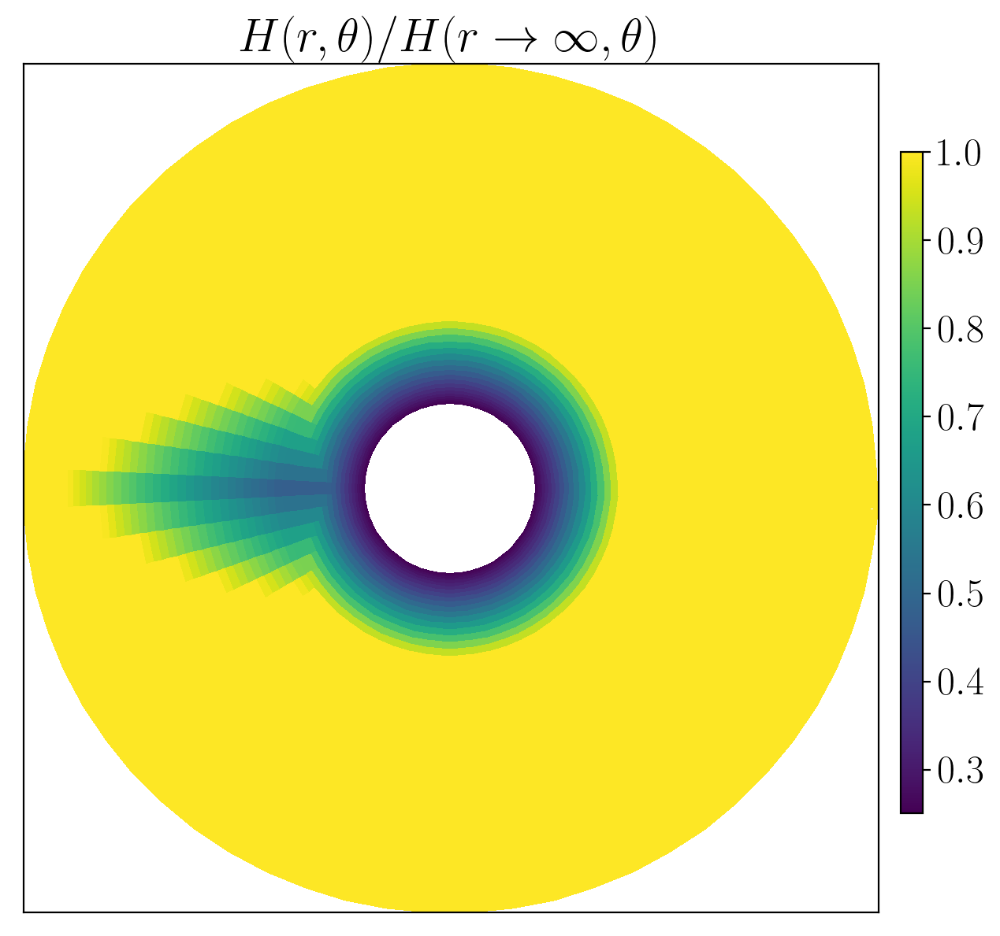

In [57]:
## variable parameters ##
Ro = 2.5;
Rs = 1;
Nθ = 64;
Nr = 64;
W = np.pi/5; 
frac = 0.7;
steep = 0.6;

plot_option = True;
##########################


## fixed and dependent parameters 
Ri= 0.5;
α = 1 
Hmin_island = Ri**(2*α);
Hmin_ridge = 1-(1-Hmin_island)*frac; 
b = -np.log(Hmin_ridge)/(2*W)
C = np.pi;

#Basis
coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')

# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)

rinv = dist.Field(bases=r_basis); rinv['g'] = r**(-1)

lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

## bathymetry ##
R,THETA = np.meshgrid(r,θ)
Hisland = R**(2*α) 
Hisland[Hisland>1] = 1
Hridge = np.exp(2*b*(np.abs(C-THETA)-W))
Hridge[Hridge>1] = 1
Hridge[R>Rs] = Hridge[R>Rs]*np.exp(steep*(R[R>Rs]-Rs))
# Hridge[R>Rs] = 1
Hridge[Hridge>1] = 1
H = np.where(Hisland<Hridge,Hisland,Hridge)

## bathymetry as field ##
Hinv = dist.Field(bases=(θ_basis,r_basis))
Hinv['g'] = H**(-1)

if plot_option==True:
    ## plot bathymetry
    R,THETA = np.meshgrid(r,θ)
    x = R*np.cos(THETA); y=R*np.sin(THETA)
    fig,(ax) = plt.subplots(1,1, figsize=(7,7))
    c=ax.pcolormesh(x,y,1/Hinv['g'].real)
    ax.set_title(r'$H(r,\theta)/H(r\to\infty, \theta)$')
    cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
    cbar=plt.colorbar(c,cax = cax,orientation='vertical',shrink = 0.5)
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC


In [58]:
%%time
## solver (edit names with each run) ##
solver = problem.build_solver(matrix_coupling=(True,True))
solver.solve_sparse(solver.subproblems[0], 40,-1/0.3) 

2022-10-14 10:57:31,264 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 4m 12s, Remaining: 0s, Rate: 4.0e-03/s
CPU times: user 3min 11s, sys: 58.1 s, total: 4min 9s
Wall time: 4min 34s


In [59]:
# extract r and \theta dimensions in more easy forms for plotting
r = r[0]; θ = θ.T[0]

In [60]:
case4_eigenvalues = 1/solver.eigenvalues.real

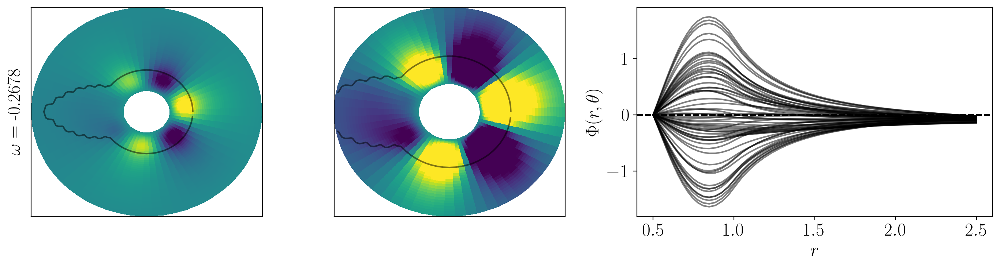

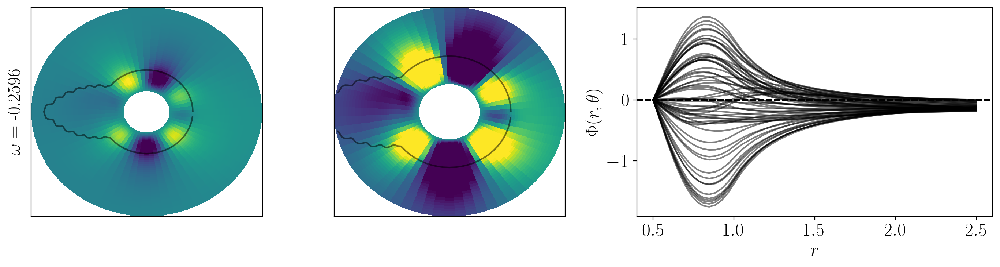

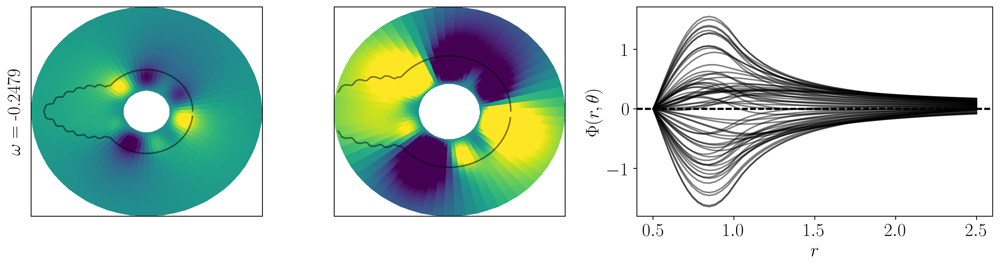

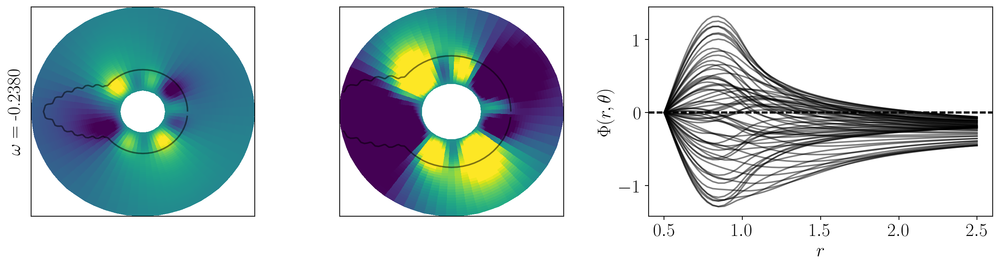

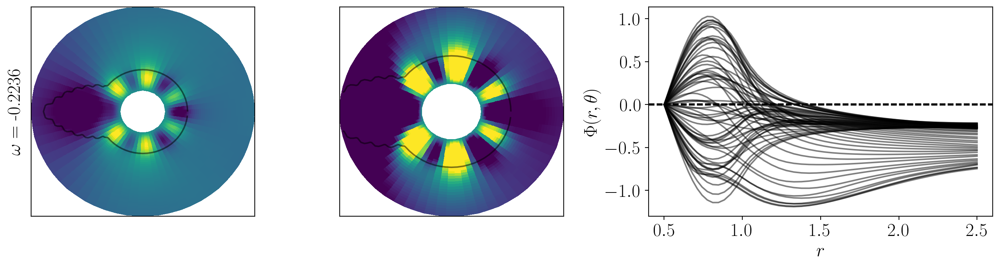

...

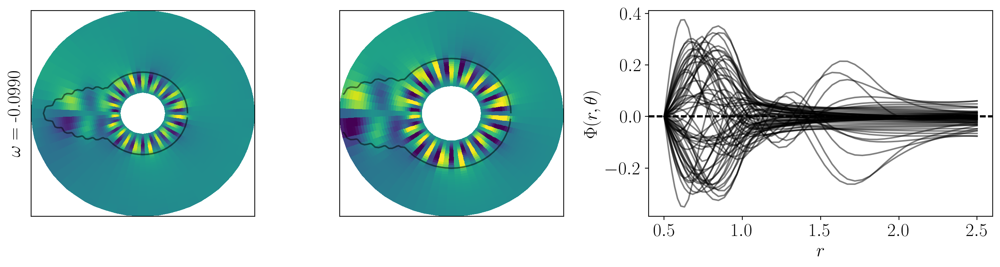

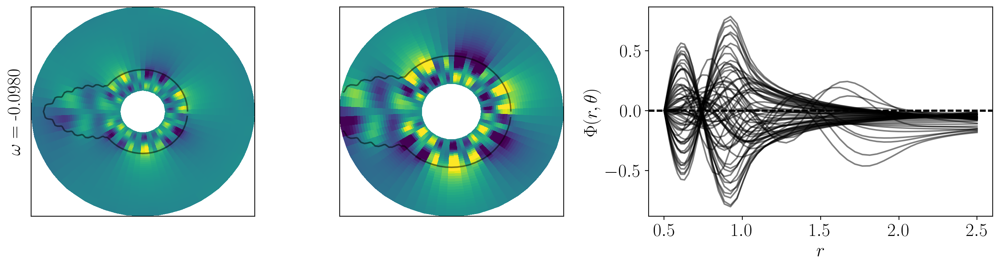

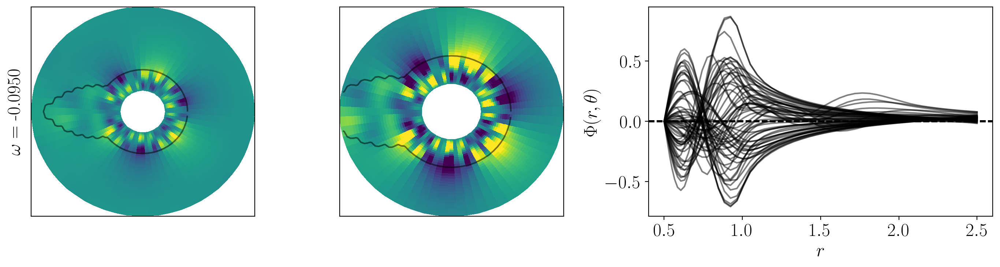

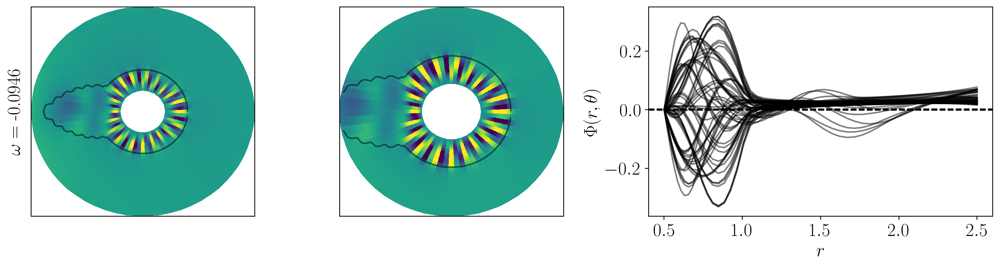

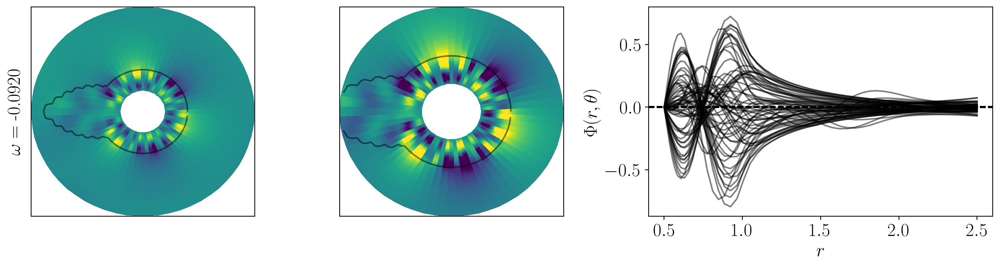

In [61]:
# case1_ridge_metric = np.zeros(40)
for i in range(40):
    eigenmode_plot(i,R,THETA,40)
#     solver.set_state(i, solver.subproblems[0].subsystems[0]) 
#     Φg = Φ['g'];ke = kinetic_energy(Φg,r,θ)
#     case1_ridge_metric[i] = kinetic_energy_metric(ke,Rs)